<a href="https://colab.research.google.com/github/ParkSlingshot/-/blob/main/Yolo_Video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('gdrive')


Mounted at gdrive


In [3]:
from google.colab import files
files.upload()

Saving obama_01.mp4 to obama_01.mp4


{'obama_01.mp4': b'\x00\x00\x00\x1cftypmp42\x00\x00\x00\x01isommp41mp42\x00\x00$\x94moov\x00\x00\x00lmvhd\x00\x00\x00\x00\xda\x0e.\xff\xda\x0e/\x10\x00\x00\x02X\x00\x00FP\x00\x01\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00@\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x00\x00$ trak\x00\x00\x00\\tkhd\x00\x00\x00\x01\xda\x0e.\xff\xda\x0e/\x10\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00FP\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00@\x00\x00\x00\x02\x80\x00\x00\x00\xfe\x00\x00\x00\x00\x00$edts\x00\x00\x00\x1celst\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00FP\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00#\x98mdia\x00\x00\x00 mdhd\x00\x00\x00\x0

In [6]:
import IPython as ip
import numpy as np
import cv2 as cv
from google.colab.patches import cv_imshow

In [7]:
weight = '/content/gdrive/MyDrive/yolo/yolov3.weights'
cfg = '/content/gdrive/MyDrive/yolo/yolov3.cfg'
names = '/content/gdrive/MyDrive/yolo/coco.names'
video = 'obama_01.mp4'

In [13]:
classes = []
with open(names, 'r') as f:
  classes = [line.strip() for line in f.readlines()]

colors = np.random.uniform(0,255, size=(len(classes),3))

In [18]:
net = cv.dnn.readNet(weight, cfg)
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0]-1] for i in net.getUnconnectedOutLayers()]

In [26]:
def Display(frame):
  ip.display.clear_output(wait=True)
  height, width, channel = frame.shape
  blob = cv.dnn.blobFromImage(frame, 0.00392,(416,416), (0,0,0), True, crop=False)
  net.setInput(blob)
  outs = net.forward(output_layers)
  class_ids = []
  boxes = []
  confidences = []
  for out in outs:
    for detection in out:
      score = detection[5:]
      class_id = np.argmax(score)
      confidence = score[class_id]
      if confidence > 0.5 :
        centerx = int(detection[0]* width)
        centery = int(detection[1]* height)
        w = int(detection[2]* width)
        h = int(detection[3]* height )
        x = int(centerx-w /2)
        y = int(centery-h/2)
        boxes.append([x,y,w,h])
        confidences.append(float(confidence))
        class_ids.append(class_id)

  indexes = cv.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
  font = cv.FONT_HERSHEY_COMPLEX

  for i in range(len(boxes)):
    if i in indexes:
      x,y,w,h = boxes[i]
      color = colors[i]
      label = str(classes[class_ids[i]])
      cv.rectangle(frame, (x,y), (x+w,y+h), color, 2)
      cv.putText(frame, label ,(x+20, y+10), font, 0.5, color, 1)
  cv_imshow(frame)

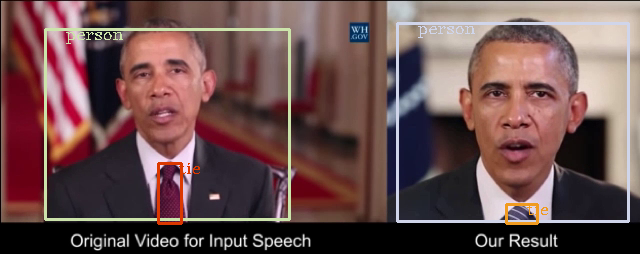

In [ ]:
cap = cv.VideoCapture(video)
while True:
  ret, frame = cap.read()
  Display(frame)